In [21]:
import pandas as pd
import matplotlib.pyplot as plt
import networkx as nx
import geopandas as gpd
import numpy as np
from shapely import wkt, centroid, distance

In [6]:
intersections = pd.read_csv('data/network/BMA_intersections.csv')
intersections['osmid'] = intersections['osmid'].astype(str)
intersections['geometry'] = intersections['geometry'].apply(wkt.loads)
intersections = gpd.GeoDataFrame(intersections)

In [15]:
us_states = gpd.read_file('data/utilization/cb_2022_us_state_500k/cb_2022_us_state_500k.shp').to_crs('EPSG:2893')

In [31]:
tracts = pd.read_csv('data/utilization_stats/tract_stats.csv')
tracts['tract'] = tracts['tract'].astype(str)
tracts['geometry'] = tracts['geometry'].apply(wkt.loads)
tracts['intersection_geom'] = tracts['intersection_geom'].apply(wkt.loads)

tracts = tracts.replace(0, np.nan)
tracts['closeness_diff'] = tracts['closeness_w_bridge'] - tracts['closeness_wo_bridge']
tracts['straightness_diff'] = tracts['straightness_w_bridge'] - tracts['straightness_wo_bridge']

tracts

,tract,geometry,residents,workers,node,intersection_geom,closeness_w_bridge,straightness_w_bridge,closeness_wo_bridge,straightness_wo_bridge,closeness_diff,straightness_diff
0,24005980000,POLYGON ((1453736.3237924455 562819.9869177692...,NaN,395.0,10090459882,POINT (1459989.7997080772 568218.4301920751),NaN,NaN,NaN,NaN,NaN,NaN
1,24005440702,POLYGON ((1459374.0885266103 617082.3975593044...,1965.0,1764.0,1015168609,POINT (1464819.0069601687 618711.6685199036),0.000051,0.815999,0.000051,0.815999,0.000000e+00,0.000000
2,24027606804,"POLYGON ((1353112.7794193993 549564.526954965,...",1143.0,884.0,10207665811,POINT (1356711.9243541602 544040.7207837251),0.000065,0.685563,0.000065,0.685563,0.000000e+00,0.000000
3,24510272004,"POLYGON ((1398641.7706029313 619765.837415919,...",1362.0,138.0,1022041008,POINT (1400039.7861625631 619649.3017997467),0.000102,0.760014,0.000102,0.760014,0.000000e+00,0.000000
4,24003730506,POLYGON ((1416322.5215973197 535865.7214170722...,1244.0,453.0,102551053,POINT (1417714.0516620143 534173.2374219407),0.000068,0.730809,0.000068,0.730809,0.000000e+00,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...
673,24005440701,POLYGON ((1454627.9534227767 613437.0390265641...,2933.0,5662.0,973408154,POINT (1459174.435352099 613001.0355349124),0.000069,0.770287,0.000069,0.770287,0.000000e+00,0.000000
674,24025303802,"POLYGON ((1490206.291272871 686649.5191058828,...",793.0,387.0,981726697,POINT (1492437.459561912 686466.7275644008),0.000044,0.781056,0.000044,0.781056,0.000000e+00,0.000000
675,24003740602,POLYGON ((1383229.1634860544 527731.9763312344...,819.0,1474.0,994213016,POINT (1388503.7930309537 529275.1844404624),0.000094,0.643770,0.000094,0.643770,0.000000e+00,0.000000
676,24005402509,"POLYGON ((1364377.597632357 626828.3828082695,...",3508.0,962.0,9956129261,POINT (1369479.1262378641 628591.5811559082),0.000048,0.766031,0.000048,0.766031,0.000000e+00,0.000000


In [28]:
nodes = pd.read_csv('data/utilization_stats/node_stats.csv')
nodes['node'] = nodes['node'].astype(str)
nodes['geometry'] = nodes['geometry'].apply(wkt.loads)
nodes = gpd.GeoDataFrame(nodes)

nodes['betweenness_diff'] = nodes['betweenness_w_bridge'] - nodes['betweenness_wo_bridge']

In [14]:
tracts

,tract,geometry,residents,workers,node,intersection_geom,closeness_w_bridge,straightness_w_bridge,closeness_wo_bridge,straightness_wo_bridge
0,24005980000,POLYGON ((1453736.3237924455 562819.9869177692...,0.0,395.0,10090459882,POINT (1459989.7997080772 568218.4301920751),0.000000,0.000000,0.000000,0.000000
1,24005440702,POLYGON ((1459374.0885266103 617082.3975593044...,1965.0,1764.0,1015168609,POINT (1464819.0069601687 618711.6685199036),0.000051,0.815999,0.000051,0.815999
2,24027606804,"POLYGON ((1353112.7794193993 549564.526954965,...",1143.0,884.0,10207665811,POINT (1356711.9243541602 544040.7207837251),0.000065,0.685563,0.000065,0.685563
3,24510272004,"POLYGON ((1398641.7706029313 619765.837415919,...",1362.0,138.0,1022041008,POINT (1400039.7861625631 619649.3017997467),0.000102,0.760014,0.000102,0.760014
4,24003730506,POLYGON ((1416322.5215973197 535865.7214170722...,1244.0,453.0,102551053,POINT (1417714.0516620143 534173.2374219407),0.000068,0.730809,0.000068,0.730809
...,...,...,...,...,...,...,...,...,...,...
673,24005440701,POLYGON ((1454627.9534227767 613437.0390265641...,2933.0,5662.0,973408154,POINT (1459174.435352099 613001.0355349124),0.000069,0.770287,0.000069,0.770287
674,24025303802,"POLYGON ((1490206.291272871 686649.5191058828,...",793.0,387.0,981726697,POINT (1492437.459561912 686466.7275644008),0.000044,0.781056,0.000044,0.781056
675,24003740602,POLYGON ((1383229.1634860544 527731.9763312344...,819.0,1474.0,994213016,POINT (1388503.7930309537 529275.1844404624),0.000094,0.643770,0.000094,0.643770
676,24005402509,"POLYGON ((1364377.597632357 626828.3828082695,...",3508.0,962.0,9956129261,POINT (1369479.1262378641 628591.5811559082),0.000048,0.766031,0.000048,0.766031


(362918.8024110333, 767615.8979266137)

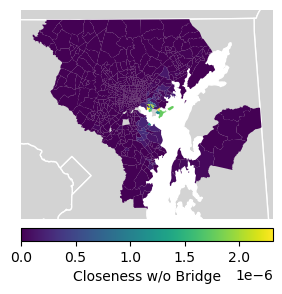

In [42]:
## Viz Tract Sources
fig, ax = plt.subplots()
fig.set_figwidth(3.25) # 1/2 page width
ax.axis('off')

gpd.GeoDataFrame(tracts, geometry='geometry').plot(
    column='closeness_diff',
    legend=True,
    legend_kwds={
        'label': 'Closeness w/o Bridge',
        'orientation': 'horizontal',
        'pad': 0.025
    },
    zorder=5,
    ax=ax
)

# bounds
xlim = ax.get_xlim()
ylim = ax.get_ylim()

# add land
us_states.plot(
    facecolor='lightgray',
    edgecolor='white',
    zorder=0,
    ax=ax
)

# final things
ax.set_xlim(xlim) # keep bounds around baltimore
ax.set_ylim(ylim)

(467175.8891744782, 689722.893223703)

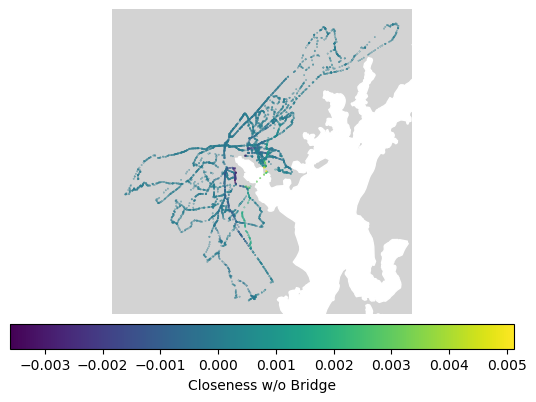

In [41]:
## Viz Tract Sources
fig, ax = plt.subplots()
fig.set_figwidth(6.5) # 1/2 page width
ax.axis('off')

nodes[nodes['betweenness_diff'] != 0].plot(
    column='betweenness_diff',
    legend=True,
    legend_kwds={
        'label': 'Closeness w/o Bridge',
        'orientation': 'horizontal',
        'pad': 0.025
    },
    markersize=0.05,
    zorder=5,
    ax=ax
)

# bounds
xlim = ax.get_xlim()
ylim = ax.get_ylim()

# add land
us_states.plot(
    facecolor='lightgray',
    edgecolor='white',
    zorder=0,
    ax=ax
)

# final things
ax.set_xlim(xlim) # keep bounds around baltimore
ax.set_ylim(ylim)

In [2]:
import pandas as pd

In [4]:
# read files
intersections = pd.read_csv('data/network/BMA_intersections.csv')
# betweenness_w_bridge = pd.read_csv('data/network_stats/betweenness_w_bridge.csv')
# betweenness_wo_bridge = pd.read_csv('data/network_stats/betweenness_wo_bridge.csv')
closeness_w_bridge = pd.read_csv('data/network_stats/closeness_w_bridge.csv')
closeness_wo_bridge = pd.read_csv('data/network_stats/closeness_wo_bridge.csv')
eigenvector_w_bridge = pd.read_csv('data/network_stats/eigenvector_w_bridge.csv')
eigenvector_wo_bridge = pd.read_csv('data/network_stats/eigenvector_wo_bridge.csv')
straightness_w_bridge = pd.read_csv('data/network_stats/straightness_w_bridge.csv')
straightness_wo_bridge = pd.read_csv('data/network_stats/straightness_wo_bridge_break_merge.csv')
# avg_spath_w_bridge = pd.read_csv('data/network_stats/avg_spath_w_bridge.csv')
# avg_spath_wo_bridge = pd.read_csv('data/network_stats/avg_spath_wo_bridge.csv')

In [5]:
network_stats = intersections.rename(columns={
    'osmid': 'node'
}).merge(
    right=closeness_w_bridge,
    on='node',
    how='outer'
).rename(columns={
    'closeness': 'closeness_w_bridge'
}).merge(
    right=closeness_wo_bridge,
    on='node',
    how='outer'
).rename(columns={
    'closeness': 'closeness_wo_bridge'
}).merge(
    right=eigenvector_w_bridge,
    on='node',
    how='outer'
).rename(columns={
    'eigenvector': 'eigenvector_w_bridge'
}).merge(
    right=eigenvector_wo_bridge,
    on='node',
    how='outer'
).rename(columns={
    'eigenvector': 'eigenvector_wo_bridge'
}).merge(
    right=straightness_w_bridge,
    on='node',
    how='outer'
).rename(columns={
    'straightness': 'straightness_w_bridge'
}).merge(
    right=straightness_wo_bridge,
    on='node',
    how='outer'
).rename(columns={
    'straightness': 'straightness_wo_bridge'
})

In [7]:
network_stats['closeness_diff'] = network_stats['closeness_w_bridge'] - network_stats['closeness_wo_bridge']
network_stats['eigenvector_diff'] = network_stats['eigenvector_w_bridge'] - network_stats['eigenvector_wo_bridge']
network_stats['straightness_diff'] = network_stats['straightness_w_bridge'] - network_stats['straightness_wo_bridge']
network_stats

,node,y,x,highway,street_count,ref,geometry,closeness_w_bridge,closeness_wo_bridge,eigenvector_w_bridge,eigenvector_wo_bridge,straightness_w_bridge,straightness_wo_bridge,closeness_diff,eigenvector_diff,straightness_diff
0,102550945,38.915418,-76.634220,turning_circle,1,NaN,POINT (1416409.1230236136 454984.4831123056),0.000019,0.000019,-1.173945e-18,-1.265474e-18,0.816875,0.816025,2.584645e-08,9.152933e-20,0.000850
1,102550947,38.914747,-76.635845,NaN,3,NaN,POINT (1415947.8823255205 454738.0770267194),0.000019,0.000019,-9.244920e-18,-1.382380e-17,0.822014,0.821157,2.599683e-08,4.578877e-18,0.000857
2,102550950,38.847269,-76.543740,NaN,3,NaN,POINT (1442277.2657510696 430280.8961677961),0.000016,0.000016,-5.645768e-19,-3.072466e-19,0.802304,0.798887,8.378295e-08,-2.573302e-19,0.003416
3,102550952,38.846923,-76.542891,NaN,1,NaN,POINT (1442519.7189324985 430156.2051449358),0.000016,0.000016,2.106774e-19,-8.175978e-19,0.801802,0.798392,8.356623e-08,1.028275e-18,0.003410
4,102550962,39.009880,-76.679609,NaN,4,NaN,POINT (1403373.9701299903 489338.90401060035),0.000023,0.000023,2.066192e-19,2.948936e-19,0.830560,0.829394,3.958456e-08,-8.827437e-20,0.001166
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
91295,11559095477,39.423903,-76.997000,NaN,3,NaN,POINT (1313181.396686215 639976.9717885511),0.000020,0.000020,-1.439576e-17,-3.433628e-17,0.860393,0.860356,1.173870e-09,1.994052e-17,0.000037
91296,11595476737,39.543180,-77.104757,NaN,4,NaN,POINT (1282789.7380315454 683441.1775068988),0.000015,0.000015,1.067197e-18,-7.509607e-19,0.850616,0.850579,8.717329e-10,1.818158e-18,0.000036
91297,11595528948,39.544575,-77.098456,NaN,3,NaN,POINT (1284567.302396418 683947.6387255767),0.000015,0.000015,1.030472e-18,-9.386000e-19,0.843692,0.843656,8.649704e-10,1.969072e-18,0.000036
91298,11819861834,39.582622,-76.948877,NaN,3,NaN,POINT (1326743.8565591644 697796.0211259687),0.000017,0.000017,-7.550418e-20,3.751188e-19,0.819198,0.819163,9.571999e-10,-4.506230e-19,0.000035


In [10]:
network_stats['geometry'] = network_stats['geometry'].apply(wkt.loads)
network_stats = gpd.GeoDataFrame(network_stats)

<Axes: >

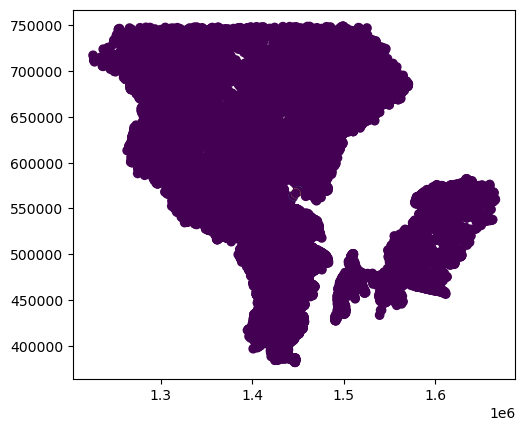

In [13]:
network_stats.plot('eigenvector_diff')

/opt/miniconda3/lib/python3.12/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


<Axes: xlabel='closeness_diff', ylabel='Density'>

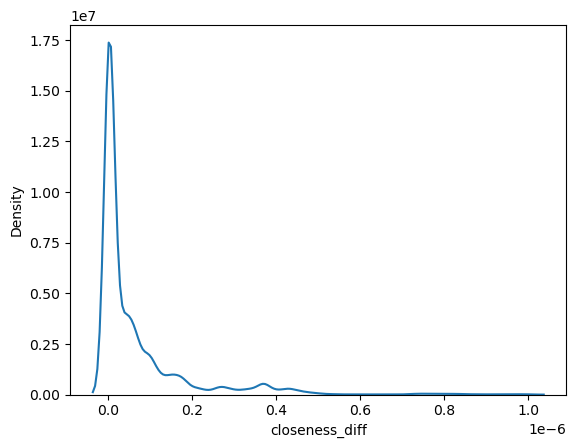

In [20]:
import seaborn as sns

sns.kdeplot(network_stats[network_stats['closeness_diff'] < 1e-6]['closeness_diff'])

In [53]:
import igraph as ig
import networkx as nx
import pandas as pd
import numpy as np

In [41]:
roads_G_nx = nx.read_gml('data/network/BMA_road_network.gml')

roads_G = ig.Graph.from_networkx(roads_G_nx)

In [38]:
len(roads_G.vs)

91300

In [48]:
start = pd.Timestamp.now()

av_path = roads_G.average_path_length(weights='length')

end = pd.Timestamp.now()
print(end - start)

av_path

0 days 00:00:42.578921


25233.607504733587

In [47]:
start = pd.Timestamp.now()

bet_cent = roads_G.betweenness(directed=True, weights='length')

end = pd.Timestamp.now()
print(end - start)

bet_cent

0 days 00:00:48.202740


[93189.0,
 0.0,
 672503.0,
 0.0,
 97362.0,
 0.0,
 8811630.0,
 0.0,
 2041493.0,
 0.0,
 1661277.0,
 243476.0,
 8180487.0,
 2665712.0,
 254334.0,
 95666.0,
 1709238.0,
 48682.0,
 0.0,
 12790479.0,
 0.0,
 13019995.0,
 213904.0,
 97362.0,
 0.0,
 100537.0,
 0.0,
 753718.0,
 0.0,
 660972.0,
 97362.0,
 0.0,
 292042.0,
 0.0,
 4225315.0,
 3426837.0,
 4192230.0,
 243226.0,
 340704.0,
 0.0,
 170416.0,
 78437.0,
 0.0,
 174198.0,
 82031.0,
 0.0,
 150656300.0,
 0.0,
 424824.0,
 0.0,
 698917.0,
 2799942.0,
 3101639.0,
 2442243.0,
 14937631.0,
 3593222.0,
 677813.0,
 652083.0,
 333710.0,
 28386084.0,
 48682.0,
 0.0,
 0.0,
 389344.0,
 340694.0,
 120785.0,
 16294163.0,
 48682.0,
 594975.0,
 25243.0,
 74728.0,
 146038.0,
 463302.0,
 18285157.0,
 7155823.0,
 0.0,
 48682.0,
 146030.0,
 0.0,
 40331360.0,
 0.0,
 0.0,
 1145369.0,
 0.0,
 152844.0,
 718610.0,
 8200923.0,
 0.0,
 48682.0,
 219044.0,
 0.0,
 0.0,
 97362.0,
 0.0,
 0.0,
 468460.0,
 385287.0,
 2111245.0,
 0.0,
 191252.0,
 97362.0,
 0.0,
 0.0,
 445623.0

In [61]:
from shapely import wkt

# nodes
intersections_df = pd.read_csv('data/network/BMA_intersections.csv')
intersections_df['geometry'] = intersections_df['geometry'].apply(wkt.loads) # convert to geometry
intersections_df['osmid'] = intersections_df['osmid'].astype(str)

In [86]:
from shapely import distance


In [91]:
np.array(roads_G.distances(0, weights='length'))

array([[    0.   ,  2236.968,  4446.133, ..., 33002.378, 33104.742,
        33489.402]])

In [113]:
def node_straightness(i: int, # node number
                      G: ig.Graph # roads graph
                      ) -> float:
    # straightness cent = 1/(n-1) * eucl_dists / net_dists
    net_dists = pd.Series(G.distances(i, weights='length')[0]) # network distance
    eucl_dists = pd.Series(distance(G.vs[i]['geometry'], G.vs.get_attribute_values('geometry'))) # euclidian distance
    n = G.vcount() # number of nodes

    return 1/(n-1) * (eucl_dists / net_dists).sum() # straightness centrality def

node_straightness(0, roads_G)

2.7577838401733197

In [114]:
x = np.arange(100)
x

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
       85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99])

In [124]:
roads_G.vcount()

3492

In [138]:
roads_df = pd.read_csv('data/network/BMA_roads.csv')
roads_df['u'], roads_df['v'] = roads_df['u'].astype(str), roads_df['v'].astype(str)

/var/folders/7l/ffzd6jqd4k1g060d9whf4v2c0000gn/T/ipykernel_92396/779083900.py:1: DtypeWarning: Columns (17,18) have mixed types. Specify dtype option on import or set low_memory=False.
  roads_df = pd.read_csv('data/network/BMA_roads.csv')


52492

In [152]:
destroyed_edges

[(52492, 52494), (52493, 52495), (52494, 52492), (52495, 52493)]

In [153]:
# bridge collapse
roads_wo_bridge_G = roads_G.copy()
destroyed_edges = roads_df[roads_df['highway'] == 'destroyed']
destroyed_edges = list(zip(destroyed_edges['u'].map(roads_G.vs.get_attribute_values('label').index),
                           destroyed_edges['v'].map(roads_G.vs.get_attribute_values('label').index))) # start and end nodes
print(f'Destroying {len(destroyed_edges)} edges...')
roads_wo_bridge_G.delete_edges(destroyed_edges) # python multiprocessing doesn't share state

Destroying 4 edges...


In [155]:
roads_G.ecount() - roads_wo_bridge_G.ecount()

4

In [154]:
pd.Series(destroyed_edges).map(lambda n1, n2: (roads_G.vs.get_attribute_values('label').index(n1), roads_G.vs.get_attribute_values('label').index(n2)))

TypeError: <lambda>() missing 1 required positional argument: 'n2'

In [123]:
pd.Series(np.arange(roads_G.vcount())).apply(node_straightness, args=[roads_G])

0       2.757784
1       2.798267
2       2.815223
3       2.353039
4       2.371891
          ...   
3487    2.411250
3488    2.431283
3489    2.414517
3490    2.432594
3491    2.357196
Length: 3492, dtype: float64

In [90]:
distance(roads_G.vs[0]['geometry'], roads_G.vs.get_attribute_values('geometry'))

array([    0.        ,  7179.99138492, 14137.04554264, ...,
       79441.32305331, 79974.4177042 , 79817.67582201])

In [71]:
node_geoms = pd.Series( # create weights series
    roads_G.vs.get_attribute_values('label')
).map(
    intersections_df.set_index('osmid')['geometry'].to_dict()
)

roads_G.vs.set_attribute_values('geometry', node_geoms)

In [74]:
list(roads_G.vs)

[igraph.Vertex(<igraph.Graph object at 0x16a642750>, 0, {'id': 0.0, 'label': '182206042', 'y': 39.109428, 'x': -75.8308465, 'street_count': 3.0, 'geometry': <POINT (1644079.859 527560.052)>, 'highway': '', 'ref': ''}),
 igraph.Vertex(<igraph.Graph object at 0x16a642750>, 1, {'id': 1.0, 'label': '182206067', 'y': 39.1203996, 'x': -75.8098225, 'street_count': 4.0, 'geometry': <POINT (1649992.962 531632.826)>, 'highway': '', 'ref': ''}),
 igraph.Vertex(<igraph.Graph object at 0x16a642750>, 2, {'id': 2.0, 'label': '182206104', 'y': 39.1328272, 'x': -75.7910896, 'street_count': 3.0, 'geometry': <POINT (1655247.328 536228.599)>, 'highway': '', 'ref': ''}),
 igraph.Vertex(<igraph.Graph object at 0x16a642750>, 3, {'id': 3.0, 'label': '182804280', 'y': 39.1519054, 'x': -76.0391998, 'street_count': 1.0, 'geometry': <POINT (1584799.451 542340.476)>, 'highway': '', 'ref': ''}),
 igraph.Vertex(<igraph.Graph object at 0x16a642750>, 4, {'id': 4.0, 'label': '182804284', 'y': 39.1485069, 'x': -76.03784

In [59]:
start = pd.Timestamp.now()

clo_cent = roads_G.closeness(mode='out', weights='length')

end = pd.Timestamp.now()
print(end - start)

clo_cent

0 days 00:00:00.639389


[2.8891750906524533e-05,
 2.753091842242567e-05,
 2.6251171199039117e-05,
 3.4674097073558034e-05,
 3.518534517865015e-05,
 2.659355816898335e-05,
 2.6256063021389398e-05,
 2.61835446857941e-05,
 3.186140764672992e-05,
 3.178071915111668e-05,
 3.9539261859727385e-05,
 4.070728208108365e-05,
 3.9468024791413865e-05,
 2.8333314298218488e-05,
 2.8465612420704687e-05,
 4.0645717765657404e-05,
 4.032790261352526e-05,
 2.6057474838911942e-05,
 2.5747475177946534e-05,
 4.4707853099573945e-05,
 2.8264515184150778e-05,
 2.8183828234224254e-05,
 4.0432875172337326e-05,
 4.061307110026851e-05,
 4.583376585377636e-05,
 4.534279559084032e-05,
 2.8421134066524254e-05,
 2.7999756001287577e-05,
 2.731142530776091e-05,
 3.1085949273849046e-05,
 3.092218701469487e-05,
 4.855726641541847e-05,
 4.9277606613865086e-05,
 4.911126130457757e-05,
 2.4609867653677192e-05,
 2.5016142659064743e-05,
 3.4826168685714196e-05,
 3.468181100679308e-05,
 2.75393419880872e-05,
 2.7410292378918057e-05,
 3.606745590462063e

In [50]:
start = pd.Timestamp.now()

dists = roads_G.distances(weights='length')

end = pd.Timestamp.now()
print(end - start)

dists

0 days 00:01:14.857464


[[0.0,
  23199.109999999997,
  23104.293999999998,
  18053.607999999997,
  17968.974999999995,
  18069.801999999996,
  14338.8,
  14710.774,
  36757.672000000035,
  37078.78600000004,
  8393.345000000001,
  8169.213000000001,
  7962.673,
  6116.258999999999,
  6109.625999999999,
  19121.554000000007,
  22005.281000000003,
  22053.806000000004,
  22132.106000000003,
  48102.208000000035,
  48218.65400000004,
  47934.99300000004,
  48223.32500000004,
  48541.51500000004,
  48672.24000000004,
  15644.249000000003,
  15745.712000000003,
  37353.435000000005,
  37525.391,
  41062.813,
  41138.563,
  41265.292,
  36252.237,
  36377.393000000004,
  55954.96700000002,
  55718.20700000002,
  55237.41400000002,
  5145.052999999999,
  52402.091000000015,
  42428.19700000002,
  42312.48500000002,
  51452.42000000001,
  51569.661000000015,
  10099.976999999999,
  10292.807999999999,
  43135.28000000003,
  40092.172999999995,
  18439.125000000004,
  18342.489000000005,
  8676.81,
  43732.72900000001

SyntaxError: invalid syntax (494019977.py, line 1)

In [16]:
weights = { # weights by road type
    'residential': 1,
    'living_street': 1,
    'tertiary_link': 1,
    'secondary_link': 2,
    'primary_link': 3,
    'tertiary': 2,
    'secondary': 3,
    'primary': 4,
    'motorway_link': 4,
    'motorway': 5,
    'trunk_link': 1,
    'trunk': 1,
    'rest_area': 1,
    'unclassified': 1,
    'disused': 1,
    'destroyed': 5, # bridge (highway)
    "['secondary', 'trunk_link']": 3,
    "['residential', 'tertiary']": 2,
    "['secondary', 'tertiary']": 3,
    "['residential', 'unclassified']": 1,
    "['unclassified', 'tertiary']": 2,
    "['secondary', 'secondary_link']": 3,
    "['unclassified', 'primary_link']": 3,
    "['residential', 'primary_link']": 3,
    "['tertiary', 'primary_link']": 3,
    "['primary', 'motorway']": 5,
    "['residential', 'living_street']": 1,
    "['motorway_link', 'motorway']": 5,
    "['motorway_link', 'tertiary']": 4,
    "['motorway_link', 'primary']": 4,
    "['disused', 'unclassified']": 1,
    "['tertiary', 'tertiary_link']": 2,
    "['primary', 'primary_link']": 4,
    "['motorway', 'trunk']": 5,
    "['primary', 'tertiary']": 4,
    "['motorway_link', 'tertiary_link']": 4,
    "['residential', 'trunk_link']": 1,
    "['residential', 'motorway_link']": 4,
    "['residential', 'secondary_link']": 2,
    "['disused', 'residential']": 1,
    "['motorway_link', 'trunk_link']": 4,
    "['unclassified', 'trunk_link']": 1,
    "['unclassified', 'residential']": 1,
    "['living_street', 'residential']": 1,
    "['tertiary', 'residential']": 2,
    "['primary', 'motorway_link']": 4,
    "['tertiary', 'secondary']": 3,
    "['primary_link', 'residential']": 3
}


In [23]:
def calc_weight(G: ig.Graph # graphs
                ) -> None:
    

    edge_weights = pd.Series( # create weights series
        roads_G.es.get_attribute_values('highway')
    ).map(
        weights
    ).replace(np.nan, 1)

    G.es.set_attribute_values('weights', edge_weights) # add weights to graph

calc_weight(roads_G)

In [52]:
cents = pd.DataFrame(index=roads_G.vs.get_attribute_values('label'))

cents['eigenvector'] = roads_G.eigenvector_centrality(directed=True, weights='weights')


cents

/var/folders/7l/ffzd6jqd4k1g060d9whf4v2c0000gn/T/ipykernel_92396/2768544918.py:3: RuntimeWarning: Weighted directed graph in eigenvector centrality at src/centrality/eigenvector.c:304
  cents['eigenvector'] = roads_G.eigenvector_centrality(directed=True, weights='weights')


,eigenvector
27029857,9.388492e-18
37018071,6.939106e-14
37018073,6.391978e-13
37018082,0.000000e+00
37018098,0.000000e+00
...,...
11771011649,1.133376e-18
11771011650,0.000000e+00
11771011652,0.000000e+00
11771011653,0.000000e+00


,,w_bridge,wo_bridge
NaN,NaN,NaN,NaN


In [163]:
arr1 = np.array([1, 2, 3, 4])
arr2 = np.array([1, 2, 6, 7])

filer = np.where(arr1 != arr2)[0]

filer

array([2, 3])

In [161]:
np.array(roads_G.distances(0, weights='length')) != np.array(roads_wo_bridge_G.distances(0, weights='length'))

ValueError: operands could not be broadcast together with shapes (1,3492) (1,91300) 

In [157]:
pd.DataFrame()

27058.562205577062

In [156]:
roads_G = ig.read(
    'data/network/BMA_road_network.gml',
    format='gml'
)
roads_G

In [62]:
list(roads_G.vs)[0]['label']

'27029857'

In [4]:
list(roads_G.es)

[igraph.Edge(<igraph.Graph object at 0x10612f150>, 0, {'key': 0.0, 'osmid': 62149677.0, 'oneway': 1.0, 'lanes': '1', 'highway': 'motorway_link', 'access': 'no', 'reversed': 0.0, 'length': 513.643, 'geometry': 0.0, 'name': '', 'maxspeed': '', 'ref': '', 'junction': '', 'bridge': '', 'width': '', 'tunnel': '', 'service': ''}),
 igraph.Edge(<igraph.Graph object at 0x10612f150>, 1, {'key': 0.0, 'osmid': 5250696.0, 'oneway': 0.0, 'lanes': '', 'highway': 'residential', 'access': '', 'reversed': 0.0, 'length': 94.816, 'geometry': 0.0, 'name': 'Sperl Avenue', 'maxspeed': '', 'ref': '', 'junction': '', 'bridge': '', 'width': '', 'tunnel': '', 'service': ''}),
 igraph.Edge(<igraph.Graph object at 0x10612f150>, 2, {'key': 0.0, 'osmid': 5250696.0, 'oneway': 0.0, 'lanes': '', 'highway': 'residential', 'access': '', 'reversed': 1.0, 'length': 94.816, 'geometry': 0.0, 'name': 'Sperl Avenue', 'maxspeed': '', 'ref': '', 'junction': '', 'bridge': '', 'width': '', 'tunnel': '', 'service': ''}),
 igraph.E

In [5]:
roads_G.es.get_attribute_values('highway').map

['motorway_link',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'secondary',
 'secondary',
 'residential',
 'residential',
 'residential',
 'tertiary',
 'tertiary',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'secondary',
 'secondary',
 'residential',
 'residential',
 'tertiary',
 'tertiary',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'residential',
 'resident

In [67]:
roads_G.vs.get_attribute_values('label')

['27029857',
 '37018071',
 '37018073',
 '37018082',
 '37018098',
 '37018099',
 '37018114',
 '37018165',
 '37018175',
 '37018198',
 '37018232',
 '37018237',
 '37018241',
 '37018248',
 '37018250',
 '37018259',
 '37018301',
 '37018303',
 '37018307',
 '37018334',
 '37018353',
 '37018435',
 '37018475',
 '37018533',
 '37018552',
 '37018562',
 '37018563',
 '37018567',
 '37018588',
 '37018590',
 '37018591',
 '37018604',
 '37018609',
 '37018638',
 '37018693',
 '37018700',
 '37018710',
 '37018716',
 '37018730',
 '37018747',
 '37018765',
 '37018772',
 '37018775',
 '37018778',
 '37018837',
 '37018857',
 '37018890',
 '37018924',
 '37018925',
 '37019000',
 '37019029',
 '37019034',
 '37019037',
 '37019040',
 '37019074',
 '37019076',
 '37019194',
 '37019198',
 '37019536',
 '37019541',
 '37019772',
 '37019793',
 '37019933',
 '37019954',
 '37019975',
 '37020566',
 '37020588',
 '37020629',
 '37020859',
 '37021481',
 '37021484',
 '37021568',
 '37021775',
 '37022393',
 '37022403',
 '37022412',
 '37022424',

In [51]:
dists = np.array(dists)